# Stipple Me This

In [1]:
! pip install nibabel

In [2]:
import nibabel as nib

# importing synthetic data generated from the Simulated Brain Database
# (https://brainweb.bic.mni.mcgill.ca/brainweb/)

minc_file_path = 'sample_data/t1_icbm_normal_1mm_pn3_rf20.mnc'

try:
    # Load the MINC image
    minc_img = nib.load(minc_file_path)

    # Access the image data as a NumPy array
    image_data = minc_img.get_fdata()

    # Access the image header information
    image_header = minc_img.header

    print(f"Successfully opened MINC file: {minc_file_path}")
    print(f"Image data shape: {image_data.shape}")
    print(f"Image header information: {image_header}")

    # You can now process 'image_data' (which is a NumPy array)
    # or extract information from 'image_header' as needed.

except FileNotFoundError:
    print(f"Error: MINC file not found at '{minc_file_path}'")
except Exception as e:
    print(f"An error occurred: {e}")

Successfully opened MINC file: sample_data/t1_icbm_normal_1mm_pn3_rf20.mnc
Image data shape: (181, 217, 181)
Image header information: <nibabel.minc1.Minc1Header object at 0x79dccee06b70>


## Image pre-processing

--- Image Data Statistics ---
count    7.109137e+06
mean     2.733103e+02
std      2.743371e+02
min      7.730891e-03
25%      2.889959e+01
50%      1.850311e+02
75%      5.037351e+02
max      1.368279e+03
dtype: float64


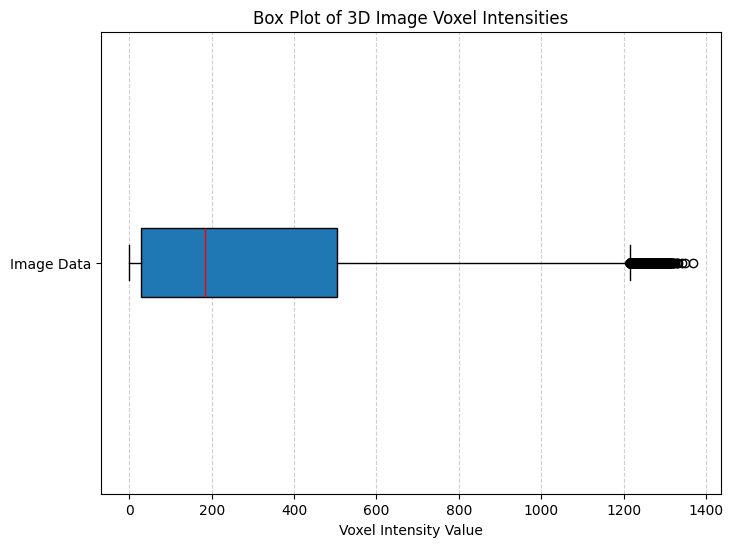

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Checking value stats of image_data for pre-processing

# Convert the NumPy array to a Pandas Series (flattened)
data_series = pd.Series(image_data.flatten())

# Use the .describe() function
statistics = data_series.describe()

print("--- Image Data Statistics ---")
print(statistics)

# 1. Flatten the 3D array into a 1D array of all voxel values
flat_data = image_data.flatten()

# 2. Create the box plot
plt.figure(figsize=(8, 6))
# The 'vert=False' argument plots it horizontally, which is often cleaner
plt.boxplot(flat_data, vert=False, patch_artist=True, medianprops={'color': 'red'})

# Add titles and labels
plt.title("Box Plot of 3D Image Voxel Intensities")
plt.xlabel("Voxel Intensity Value")
plt.yticks([1], ['Image Data'])
plt.grid(True, axis='x', linestyle='--', alpha=0.6)

# Display the plot
plt.show()

In [4]:
# processing outliers
def remove_outliers_iqr(image_data_3d):
    """
    Removes outliers from 3D image data using the IQR method by replacing
    outlying values with the nearest boundary value (capping/clamping).
    """

    # Flatten the data for statistical calculation using Pandas Series
    flat_data = image_data_3d.flatten()
    data_series = pd.Series(flat_data)

    # Calculate Q1 (25th percentile) and Q3 (75th percentile)
    Q1 = data_series.quantile(0.25)
    Q3 = data_series.quantile(0.75)

    # Calculate the Interquartile Range (IQR)
    IQR = Q3 - Q1

    # Define the lower and upper bounds for acceptable data
    # A common multiplier for "mild outliers" is 1.5
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    print(f"IQR Lower Bound: {lower_bound:.4f}, Upper Bound: {upper_bound:.4f}")
    print(f"Original Data Range: [{np.min(image_data_3d):.4f}, {np.max(image_data_3d):.4f}]")

    # Use NumPy's clip function to cap the actual 3D data array
    # Values outside the bounds are set to the bound itself
    cleaned_data = np.clip(image_data_3d, lower_bound, upper_bound)

    print(f"Capped Data Range: [{np.min(cleaned_data):.4f}, {np.max(cleaned_data):.4f}]")

    return cleaned_data

# Executing outlier processing
image_data_iqr_cleaned = remove_outliers_iqr(image_data)

IQR Lower Bound: -683.3537, Upper Bound: 1215.9885
Original Data Range: [0.0077, 1368.2795]
Capped Data Range: [0.0077, 1215.9885]


In [5]:
# Normalizing the values
def normalize_image_data(data):
    """
    Normalizes 3D or 2D image data to the range [0.0, 1.0].

    Args:
        data (np.ndarray): Input NumPy array (float or integer type).

    Returns:
        np.ndarray: Normalized data as a float32 NumPy array.
    """
    # Convert data to float if it's not already
    data = data.astype(np.float32)

    # Find the minimum and maximum values in the entire 3D volume
    data_min = np.min(data)
    data_max = np.max(data)

    # Avoid division by zero if the image is a single constant color/value
    if data_min == data_max:
        return np.zeros_like(data, dtype=np.float32)

    # Apply min-max normalization formula
    normalized_data = (data - data_min) / (data_max - data_min)

    return normalized_data

# Executing normalization
norm_image_data = normalize_image_data(image_data_iqr_cleaned)

## Generating Stipple Vizualization

In [8]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

lower_limit = 0.6
upper_limit = 0.7
mask = (norm_image_data > lower_limit) & (norm_image_data < upper_limit)
points_coords = np.where(mask)

intensities = norm_image_data[mask]

# --- Prepare Data Trace ---
# Unpack the tuple of arrays into individual X, Y, and Z coordinate arrays
x_coords = points_coords[0]
y_coords = points_coords[1]
z_coords = points_coords[2]

# Prepare Data Trace with unpacked coordinates
GLOBAL_CMIN = np.min(intensities)
GLOBAL_CMAX = np.max(intensities)

plot_data = go.Scatter3d(
    x=x_coords, # <-- Use the correct X array
    y=y_coords, # <-- Use the correct Y array
    z=z_coords, # <-- Use the correct Z array
    mode='markers',
    marker=dict(
        size=1,
        color=intensities,
        colorscale='Plasma',
        opacity=1.0,
        cmin=GLOBAL_CMIN,
        cmax=GLOBAL_CMAX,
        colorbar=dict(title='Intensity', x=1.05)
    ),
    name='3D Points',
    showlegend=False
)


# --- Create Subplots Grid (2x2) ---
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}],
           [{'type': 'surface'}, {'type': 'surface'}]],
    subplot_titles=("Default View", "Sagital View (Facing XY Plane)",
                    "Coronal View (Facing XZ Plane)", "Transversal View (Facing YZ Plane)")
)

# Define Camera Settings for specific views
camera_xy = dict(eye=dict(x=0, y=0, z=1.10))
camera_xz = dict(eye=dict(x=0, y=1.10, z=0))
camera_yz = dict(eye=dict(x=1.10, y=0, z=0))
camera_default = dict(eye=dict(x=1, y=1, z=1))

# Add the *same* data trace to all 4 subplots
fig.add_trace(plot_data, row=1, col=1)
fig.add_trace(plot_data, row=1, col=2)
fig.add_trace(plot_data, row=2, col=1)
fig.add_trace(plot_data, row=2, col=2)

# Update layout to apply camera angles and square aspect ratio settings
fig.update_layout(
    height=1500,
    width=1500,
    title=dict(
        text="3D Point Cloud (Stipples) from Multiple Orthographic Views",
        x=0.5,  # <-- Center the title horizontally (0.0 is left, 1.0 is right)
        xref="paper",
        xanchor="center", # Ensure anchor point is the center of the text
        yanchor="top"
    ),
    scene1_camera=camera_default,
    scene2_camera=camera_xy,
    scene3_camera=camera_xz,
    scene4_camera=camera_yz
)

# Crucially, update scenes to ensure the aspect ratio is correct.
fig.update_scenes(
    aspectmode='cube',
    xaxis=dict(showticklabels=False),
    yaxis=dict(showticklabels=False),
    zaxis=dict(showticklabels=False)
)

fig.show()